In [1]:
from chembl_webresource_client.new_client import new_client
import pandas as pd

from rdkit import Chem
from rdkit.Chem import Draw
from rdkit.Chem import PandasTools
from rdkit.Chem.Draw import IPythonConsole
from rdkit.Chem import AllChem
from rdkit.Chem import rdFingerprintGenerator
from rdkit import DataStructs

from sklearn.manifold import TSNE

from IPython.display import SVG
from rdkit.Chem import rdDepictor
from rdkit.Chem.Draw import rdMolDraw2D
from rdkit.Chem.PandasTools import ChangeMoleculeRendering

#Bokeh library for plotting
import json
from bokeh.plotting import figure, show, output_notebook, ColumnDataSource
from bokeh.models import HoverTool
from bokeh.transform import factor_cmap
from bokeh.plotting import figure, output_file, save
output_notebook()

Loading BokehJS ...

## Getting the small molecule drugs from ChEMBL

[ChEMBL](https://www.ebi.ac.uk/chembl/) is a manually curated database of bioactive molecules with drug-like properties. It brings together chemical, bioactivity and genomic data to aid the translation of genomic information into effective new drugs. Here we use the python client library of [ChEMBL API](https://github.com/chembl/chembl_webresource_client) to download the [SMILES](https://en.wikipedia.org/wiki/Simplified_molecular-input_line-entry_system) for all of the approved small molecule drugs and put them into a Pandas dataframe. 

In [2]:
molecule = new_client.molecule
approved_drugs = molecule.filter(max_phase=4)
small_molecule_drugs = [x for x in approved_drugs if x['molecule_type'] == 'Small molecule']

Extract information we need: (1) drug name (2) CHEMBL ID and (3) Canonical SMILES.

In [3]:
struct_list = [(x['pref_name'], x['molecule_chembl_id'],x['molecule_structures'])for x in small_molecule_drugs if x]
smiles_list = [(a,b,c['canonical_smiles']) for (a,b,c) in struct_list if c]

In [4]:
smiles_df = pd.DataFrame(smiles_list)
smiles_df.columns = ['Name','ChEMBL_ID','SMILES']
print(f'We downloaded {smiles_df.shape[0]} small molecule drugs from ChEMBL.')

We downloaded 3147 small molecule drugs from ChEMBL.


Let check the data.

In [5]:
smiles_df.head()

,Name,ChEMBL_ID,SMILES
0,PRAZOSIN,CHEMBL2,COc1cc2nc(nc(N)c2cc1OC)N3CCN(CC3)C(=O)c4occc4
1,NICOTINE,CHEMBL3,CN1CCC[C@H]1c2cccnc2
2,OFLOXACIN,CHEMBL4,CC1COc2c(N3CCN(C)CC3)c(F)cc4C(=O)C(=CN1c24)C(=O)O
3,NALIDIXIC ACID,CHEMBL5,CCN1C=C(C(=O)O)C(=O)c2ccc(C)nc12
4,INDOMETHACIN,CHEMBL6,COc1ccc2c(c1)c(CC(=O)O)c(C)n2C(=O)c3ccc(Cl)cc3


In [6]:
smiles_df.to_csv('data/small_molecule_drug.csv', index = False)

## Molecular Fingerprints

Add RDKit Mol column to the dataframe.

In [7]:
PandasTools.AddMoleculeColumnToFrame(smiles_df,smilesCol='SMILES')

,Name,ChEMBL_ID,SMILES,ROMol
0,PRAZOSIN,CHEMBL2,COc1cc2nc(nc(N)c2cc1OC)N3CCN(CC3)C(=O)c4occc4,

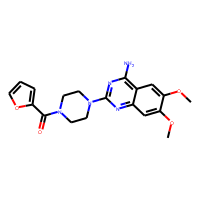

In [8]:
smiles_df.head(1)

Generare [ECFP4](https://docs.chemaxon.com/display/docs/Extended+Connectivity+Fingerprint+ECFP) fingerprint for each drug. 

In [9]:
ECFP4_fps = [AllChem.GetMorganFingerprintAsBitVect(x,2) for x in smiles_df['ROMol']]

## Dimensionality Reduction of Features

Use t-SNE to reduce the dimension of fetures into 2 for visualization.

In [10]:
tsne = TSNE(random_state=0).fit_transform(ECFP4_fps)

Define some functions for interactive visualization. Some of the code are inspried by [mol2vec_notebook](https://github.com/samoturk/mol2vec_notebooks/tree/master/Notebooks).

In [11]:
def _prepareMol(mol,kekulize):
    mc = Chem.Mol(mol.ToBinary())
    if kekulize:
        try:
            Chem.Kekulize(mc)
        except:
            mc = Chem.Mol(mol.ToBinary())
    if not mc.GetNumConformers():
        rdDepictor.Compute2DCoords(mc)
    return mc

def moltosvg(mol,molSize=(450,200),kekulize=True,drawer=None,**kwargs):
    mc = _prepareMol(mol,kekulize)
    if drawer is None:
        drawer = rdMolDraw2D.MolDraw2DSVG(molSize[0],molSize[1])
    drawer.DrawMolecule(mc,**kwargs)
    drawer.FinishDrawing()
    svg = drawer.GetDrawingText()
    return SVG(svg.replace('svg:',''))

In [12]:
svgs = [moltosvg(m).data for m in smiles_df.ROMol]

In [13]:
ChangeMoleculeRendering(renderer='PNG')


source = ColumnDataSource(data=dict(x=tsne[:,0], y=tsne[:,1], desc= smiles_df.Name, 
                                    svgs=svgs))

hover = HoverTool(tooltips="""
    <div>
        <div>@svgs{safe}
        </div>
        <div>
            <span style="font-size: 17px; font-weight: bold;">@desc</span>
        </div>
    </div>
    """
)
interactive_map = figure(plot_width=1000, plot_height=1000, tools=['reset,box_zoom,wheel_zoom,zoom_in,zoom_out,pan',hover],
           title="Small Molecule Drug (ECFP4)")



interactive_map.circle('x', 'y', size=5, source=source, fill_alpha=0.2);



In [14]:
show(interactive_map)

In [15]:
output_file("results/samll_molecule_drug_ECFP4.html")
save(interactive_map)

'G:\\My Drive\\XinhaoLi74.github.io\\_jupyters\\results\\samll_molecule_drug_ECFP4.html'